In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from copy import copy
from scipy import stats
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go

In [2]:
stocks = pd.read_csv(r"stock.csv")

In [3]:
stocks.sort_values('Date',ascending=True)

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,60.198570,75.510002,30.120001,12.130000,175.929993,180.550003,28.250000,313.644379,1295.500000
1,2012-01-13,59.972858,74.599998,30.070000,12.350000,178.419998,179.160004,22.790001,311.328064,1289.089966
2,2012-01-17,60.671429,75.239998,30.250000,12.250000,181.660004,180.000000,26.600000,313.116364,1293.670044
3,2012-01-18,61.301430,75.059998,30.330000,12.730000,189.440002,181.070007,26.809999,315.273285,1308.040039
4,2012-01-19,61.107143,75.559998,30.420000,12.800000,194.449997,180.520004,26.760000,318.590851,1314.500000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,440.250000,174.279999,29.850000,16.719999,3205.030029,125.449997,1485.020020,1473.609985,3327.770020
2155,2020-08-06,455.609985,172.199997,29.840000,18.459999,3225.000000,126.120003,1489.579956,1500.099976,3349.159912
2156,2020-08-07,444.450012,170.020004,30.020000,19.030001,3167.459961,124.959999,1452.709961,1494.489990,3351.280029
2157,2020-08-10,450.910004,179.410004,30.200001,21.650000,3148.159912,127.110001,1418.569946,1496.099976,3360.469971


In [4]:
# No of stocks
len(stocks.columns[1:])

9

In [5]:
for i in stocks.columns[1:].values :
    print (i)

AAPL
BA
T
MGM
AMZN
IBM
TSLA
GOOG
sp500


In [6]:
stocks.describe()
# stocks with min dispersion T
#Amzon max price 3225
# sp500 avg 2218

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000,2159.000000
mean,140.819823,189.942700,35.162899,23.105743,915.665665,161.853001,259.600815,783.712512,2218.749554
std,70.827601,103.678586,3.207490,6.963847,697.838905,25.561938,210.988003,334.448057,537.321727
min,55.790001,67.239998,26.770000,7.140000,175.929993,94.769997,22.790001,278.481171,1278.040039
25%,89.165714,124.015000,33.040001,18.545000,316.490005,142.769997,184.595001,527.214416,1847.984985
50%,116.599998,142.419998,34.930000,23.780001,676.010010,156.949997,231.960007,737.599976,2106.629883
75%,175.019997,297.044998,37.419998,28.430000,1593.645019,185.974998,307.350006,1079.744995,2705.810059
max,455.609985,440.619995,43.470001,38.029999,3225.000000,215.800003,1643.000000,1568.489990,3386.149902


In [7]:
stocks.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [8]:
stocks.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2159 entries, 0 to 2158
Data columns (total 10 columns):
Date     2159 non-null object
AAPL     2159 non-null float64
BA       2159 non-null float64
T        2159 non-null float64
MGM      2159 non-null float64
AMZN     2159 non-null float64
IBM      2159 non-null float64
TSLA     2159 non-null float64
GOOG     2159 non-null float64
sp500    2159 non-null float64
dtypes: float64(9), object(1)
memory usage: 168.8+ KB


In [9]:
def show_plot(df,fig_title):
    df.plot(x='Date',figsize=(15,7),linewidth=3,title=fig_title)
    plt.grid()
    plt.show()
    

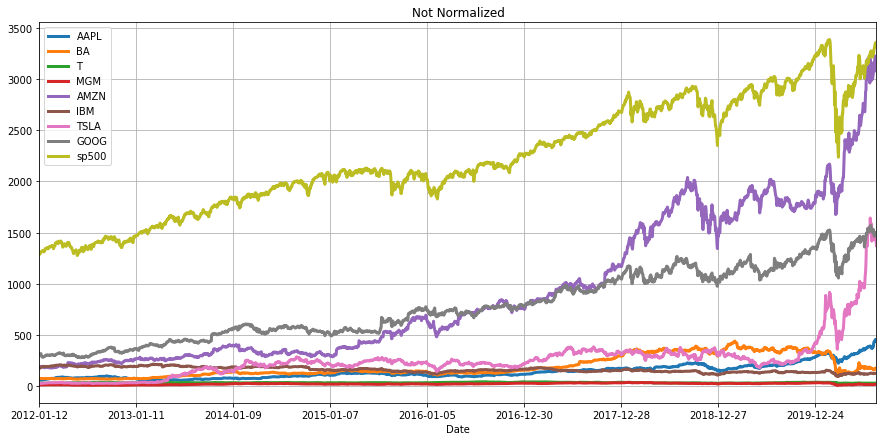

In [10]:
show_plot(stocks,'Not Normalized')

In [11]:
def nom(df):
    x = df.copy()
    for i in x.columns[1:]:
        x[i] = x[i].div(x[i].iloc[0])
    return x

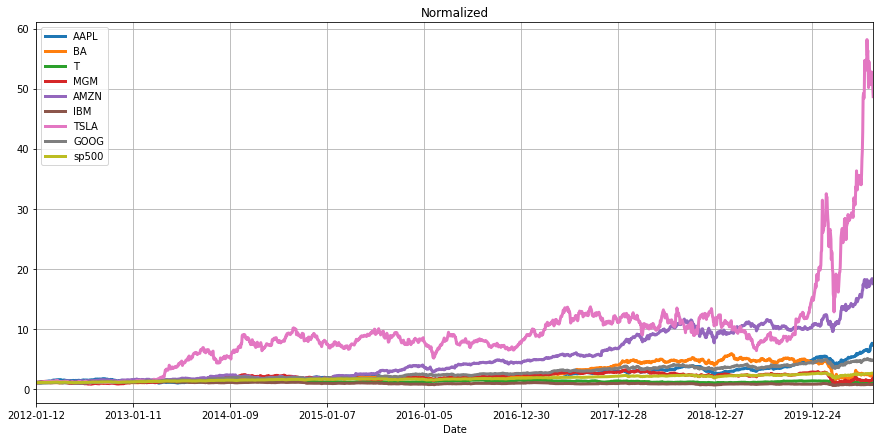

In [12]:
show_plot(nom(stocks),'Normalized')

In [13]:
def interactive_plot(df,title):
    fig  = px.line(title = title)
    for i in df.columns[1:]:
        fig.add_scatter(x= df['Date'],y=df[i], name = i)
    fig.show()

In [14]:
interactive_plot(nom(stocks),'Normalized')

In [15]:
daily = stocks.copy()


In [16]:
def dailyreturn(df):
    x  = df.copy()
    for i in x.columns[1:]:
        x[i+'daily_return'] = x[i].pct_change()
    return x

In [17]:
daily = dailyreturn(daily)

In [18]:
daily.fillna(0,inplace=True)

In [19]:
daily  = daily.drop(columns=stocks.columns[1:])

In [20]:
daily

,Date,AAPLdaily_return,BAdaily_return,Tdaily_return,MGMdaily_return,AMZNdaily_return,IBMdaily_return,TSLAdaily_return,GOOGdaily_return,sp500daily_return
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.003749,-0.012051,-0.001660,0.018137,0.014153,-0.007699,-0.193274,-0.007385,-0.004948
2,2012-01-17,0.011648,0.008579,0.005986,-0.008097,0.018159,0.004689,0.167179,0.005744,0.003553
3,2012-01-18,0.010384,-0.002392,0.002645,0.039184,0.042827,0.005944,0.007895,0.006889,0.011108
4,2012-01-19,-0.003169,0.006661,0.002967,0.005499,0.026446,-0.003038,-0.001865,0.010523,0.004939
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.003625,0.055794,-0.005332,0.000000,0.021091,-0.003099,-0.001332,0.005898,0.006430
2155,2020-08-06,0.034889,-0.011935,-0.000335,0.104067,0.006231,0.005341,0.003071,0.017976,0.006428
2156,2020-08-07,-0.024495,-0.012660,0.006032,0.030878,-0.017842,-0.009198,-0.024752,-0.003740,0.000633
2157,2020-08-10,0.014535,0.055229,0.005996,0.137677,-0.006093,0.017206,-0.023501,0.001077,0.002742


In [21]:
interactive_plot(daily,"daily returns")
# MGM stocks drop significatnly on march 16 and gain back on march 24. 

In [22]:
cr = daily.corr()

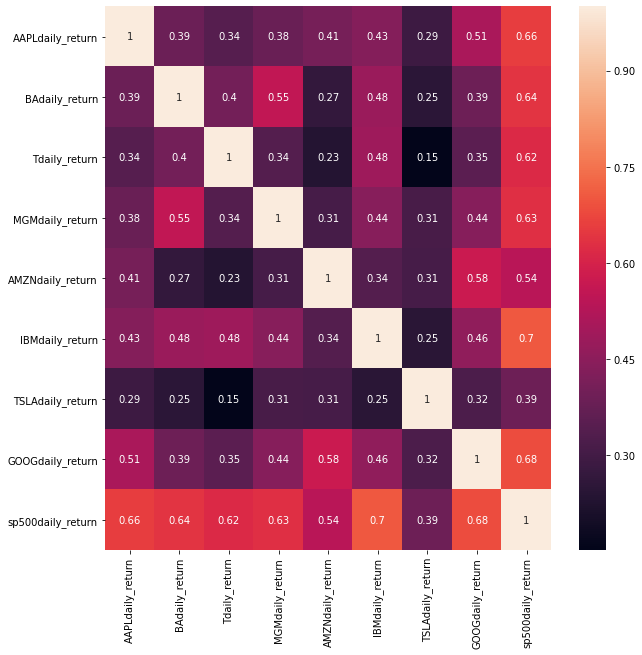

In [23]:
plt.figure(figsize=(10,10))
sns.heatmap(cr,annot=True)
#AAPL AND IBM are top positive coorelated to sp500
#very low coorelation between amazon and boeing 0.27
#some positive coorealtion between boeing and MGM

C:\Users\akars\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\tools.py:307: MatplotlibDeprecationWarning:


The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.

C:\Users\akars\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\tools.py:307: MatplotlibDeprecationWarning:


The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.

C:\Users\akars\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\tools.py:313: MatplotlibDeprecationWarning:


The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.

C:\Users\akars\Anaconda3\lib\site-packages\pandas\plotting\_matplotlib\tools.py:313: MatplotlibDeprecationWarning:


The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor r

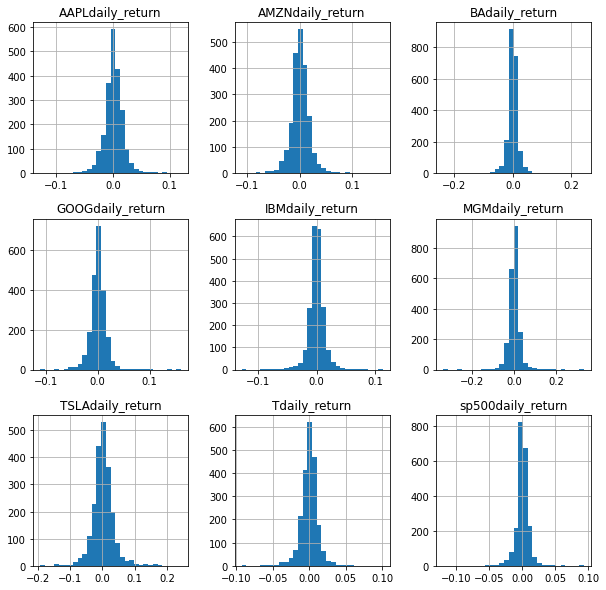

In [24]:
daily.hist(figsize=(10,10),bins=30);

In [25]:
data=[]
for i in daily.columns[1:]:
    data.append(daily[i].values)


In [26]:
fig = ff.create_distplot(data,daily.columns[1:])
fig.show()

Stocks like sp500, Google, t are safer with daily return distributions differences not ranging so much.

Tesla , MGM and BA seems to be risky with high variations in daily returns.

# Asset Allocation and Portfolio Daily Return

We can start with allocating random weightages to asset allocations to the 9 securities. Assumption of using 1 M as funds for allocation.

In [27]:
np.random.seed()

In [28]:
weights = np.array(np.random.random(9))

In [29]:
weights = weights/np.sum(weights)

In [30]:
weights

array([0.10622435, 0.0972623 , 0.05764674, 0.04819735, 0.16212112,
       0.07391402, 0.18683133, 0.20394891, 0.06385387])

In [31]:
df_portfolio = nom(stocks)

In [32]:
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2012-01-13,0.996251,0.987949,0.998340,1.018137,1.014153,0.992301,0.806726,0.992615,0.995052
2,2012-01-17,1.007855,0.996424,1.004316,1.009893,1.032570,0.996954,0.941593,0.998317,0.998587
3,2012-01-18,1.018320,0.994040,1.006972,1.049464,1.076792,1.002880,0.949027,1.005193,1.009680
4,2012-01-19,1.015093,1.000662,1.009960,1.055235,1.105269,0.999834,0.947257,1.015771,1.014666
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,7.313297,2.308039,0.991036,1.378401,18.217644,0.694821,52.567080,4.698347,2.568715
2155,2020-08-06,7.568452,2.280493,0.990704,1.521847,18.331155,0.698532,52.728494,4.782805,2.585226
2156,2020-08-07,7.383066,2.251622,0.996680,1.568838,18.004093,0.692107,51.423361,4.764919,2.586862
2157,2020-08-10,7.490377,2.375977,1.002656,1.784831,17.894390,0.704016,50.214865,4.770052,2.593956


In [33]:
for counter,stock in enumerate(df_portfolio.columns[1:]):
    df_portfolio[stock]= df_portfolio[stock]*weights[counter]*1000000
    

In [34]:
df_portfolio['portfolio_dailyworth'] = df_portfolio[df_portfolio != 'Date'].sum(axis=1)

C:\Users\akars\Anaconda3\lib\site-packages\pandas\core\ops\__init__.py:1115: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



In [35]:
df_portfolio['daily_porfolio_change'] = df_portfolio['portfolio_dailyworth'].pct_change()

In [36]:
df_portfolio.fillna(0,inplace=True)

In [37]:
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,portfolio_dailyworth,daily_porfolio_change
0,2012-01-12,106224.353758,97262.298565,57646.744737,48197.354452,1.621211e+05,73914.016161,1.868313e+05,203948.906579,63853.873614,1.000000e+06,0.000000
1,2012-01-13,105826.070023,96090.148143,57551.047699,49071.502678,1.644157e+05,73344.974860,1.507216e+05,202442.710571,63537.929576,9.630017e+05,-0.036998
2,2012-01-17,107058.744703,96914.514047,57895.550146,48674.162575,1.674014e+05,73688.854544,1.759191e+05,203605.562049,63763.676949,9.949215e+05,0.033146
3,2012-01-18,108170.423088,96682.661136,58048.662344,50581.395068,1.745707e+05,74126.896712,1.773079e+05,205008.111270,64471.959345,1.008969e+06,0.014119
4,2012-01-19,107827.590841,97326.696999,58220.913568,50859.533140,1.791875e+05,73901.735095,1.769772e+05,207165.376005,64790.364234,1.016257e+06,0.007223
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,776850.209932,224485.139024,57129.989152,66435.261191,2.953465e+06,51357.036564,9.821178e+06,958222.640949,164022.390021,1.507315e+07,0.004584
2155,2020-08-06,803953.918215,221805.947259,57110.850127,73348.978977,2.971867e+06,51631.325312,9.851335e+06,975447.896881,165076.675981,1.517158e+07,0.006530
2156,2020-08-07,784261.408578,218997.959914,57455.352574,75613.825509,2.918844e+06,51156.439945,9.607495e+06,971799.973987,165181.174385,1.485080e+07,-0.021143
2157,2020-08-10,795660.491239,231092.953416,57799.856935,86024.132225,2.901059e+06,52036.613193,9.381710e+06,972846.875849,165634.137253,1.464386e+07,-0.013935


In [38]:
def portfolio_alloc(df,weights):
    df_portfolio = stocks.copy()
    df_portfolio = nom(df_portfolio)
    for i,j in enumerate(df_portfolio.columns[1:]):
        df_portfolio[j]=df_portfolio[j]*weights[i]*1000000
    df_portfolio['dailyworth in $'] = df_portfolio[df_portfolio !='Date'].sum(axis=1)
    
    df_portfolio['%returns'] = df_portfolio['dailyworth in $'].pct_change()*100
    df_portfolio['%returns'][0]=0
    
    return df_portfolio

In [39]:
df_portfolio=portfolio_alloc(stocks,weights)

In [40]:
fig =  px.line(x= df_portfolio.Date, y = df_portfolio['%returns'], title = 'Portfolio daily returns')
fig.show()

Returns seems to be more stable because its diversified.

In [41]:
interactive_plot(df_portfolio.drop(columns = ['dailyworth in $','%returns'],axis=1),'Portfolio individual stocks worth over time')

In [42]:
fig = px.histogram(df_portfolio,x='%returns')
fig.show()
# majority of the daily returns is within +- 5 SD . ie 5 % change max (drop or increase)

In [43]:
fig = px.line(x=df_portfolio.Date, y = df_portfolio['dailyworth in $'],title = 'Portfolio allocations')
fig.show()

In [44]:
df_portfolio

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500,dailyworth in $,%returns
0,2012-01-12,106224.353758,97262.298565,57646.744737,48197.354452,1.621211e+05,73914.016161,1.868313e+05,203948.906579,63853.873614,1.000000e+06,0.000000
1,2012-01-13,105826.070023,96090.148143,57551.047699,49071.502678,1.644157e+05,73344.974860,1.507216e+05,202442.710571,63537.929576,9.630017e+05,-3.699830
2,2012-01-17,107058.744703,96914.514047,57895.550146,48674.162575,1.674014e+05,73688.854544,1.759191e+05,203605.562049,63763.676949,9.949215e+05,3.314615
3,2012-01-18,108170.423088,96682.661136,58048.662344,50581.395068,1.745707e+05,74126.896712,1.773079e+05,205008.111270,64471.959345,1.008969e+06,1.411892
4,2012-01-19,107827.590841,97326.696999,58220.913568,50859.533140,1.791875e+05,73901.735095,1.769772e+05,207165.376005,64790.364234,1.016257e+06,0.722340
...,...,...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,776850.209932,224485.139024,57129.989152,66435.261191,2.953465e+06,51357.036564,9.821178e+06,958222.640949,164022.390021,1.507315e+07,0.458388
2155,2020-08-06,803953.918215,221805.947259,57110.850127,73348.978977,2.971867e+06,51631.325312,9.851335e+06,975447.896881,165076.675981,1.517158e+07,0.653033
2156,2020-08-07,784261.408578,218997.959914,57455.352574,75613.825509,2.918844e+06,51156.439945,9.607495e+06,971799.973987,165181.174385,1.485080e+07,-2.114301
2157,2020-08-10,795660.491239,231092.953416,57799.856935,86024.132225,2.901059e+06,52036.613193,9.381710e+06,972846.875849,165634.137253,1.464386e+07,-1.393468


In [45]:
cumulative_returns = ( df_portfolio['dailyworth in $'][-1:] - df_portfolio['dailyworth in $'][0])/df_portfolio['dailyworth in $'][0]*100
print(f"cummulative returns is {cumulative_returns.values[0]}%")

cummulative returns is 1325.4427380083594%


In [46]:
print(f"standard deviation for portfolio is {df_portfolio['%returns'].std()}")

standard deviation for portfolio is 1.8773930572722983


In [47]:
print(f"average for portfolio is {df_portfolio['%returns'].mean()}")

average for portfolio is 0.1407837594063043


In [48]:
#252 trading days
sharpe_ratio = (df_portfolio['%returns'].mean()/df_portfolio['%returns'].std())*np.sqrt(252)

In [49]:
sharpe_ratio

1.1904128906293499

# Capital Asset Pricing Model (CAPM)

In [50]:
daily

,Date,AAPLdaily_return,BAdaily_return,Tdaily_return,MGMdaily_return,AMZNdaily_return,IBMdaily_return,TSLAdaily_return,GOOGdaily_return,sp500daily_return
0,2012-01-12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2012-01-13,-0.003749,-0.012051,-0.001660,0.018137,0.014153,-0.007699,-0.193274,-0.007385,-0.004948
2,2012-01-17,0.011648,0.008579,0.005986,-0.008097,0.018159,0.004689,0.167179,0.005744,0.003553
3,2012-01-18,0.010384,-0.002392,0.002645,0.039184,0.042827,0.005944,0.007895,0.006889,0.011108
4,2012-01-19,-0.003169,0.006661,0.002967,0.005499,0.026446,-0.003038,-0.001865,0.010523,0.004939
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,0.003625,0.055794,-0.005332,0.000000,0.021091,-0.003099,-0.001332,0.005898,0.006430
2155,2020-08-06,0.034889,-0.011935,-0.000335,0.104067,0.006231,0.005341,0.003071,0.017976,0.006428
2156,2020-08-07,-0.024495,-0.012660,0.006032,0.030878,-0.017842,-0.009198,-0.024752,-0.003740,0.000633
2157,2020-08-10,0.014535,0.055229,0.005996,0.137677,-0.006093,0.017206,-0.023501,0.001077,0.002742


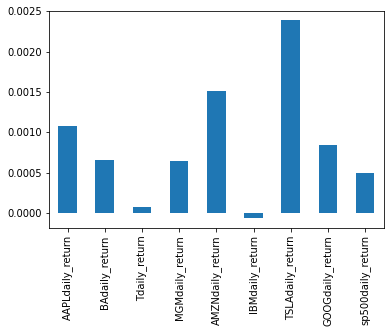

In [51]:
daily.mean().plot(kind='bar')

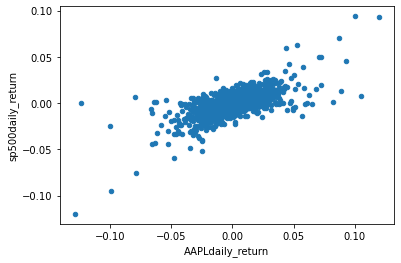

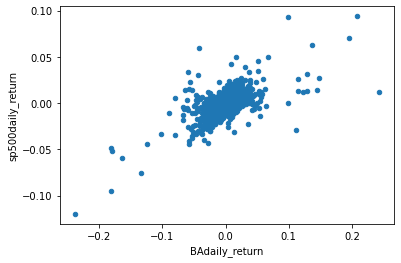

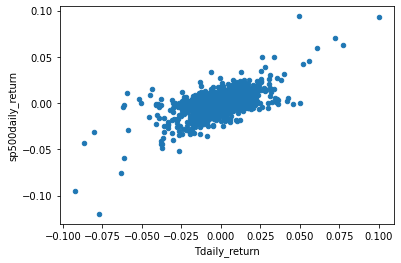

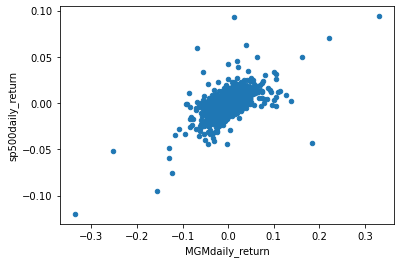

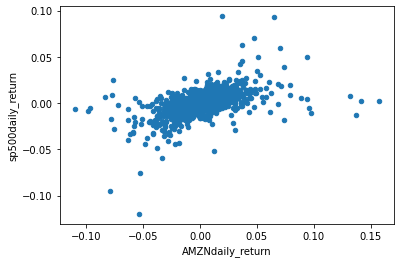

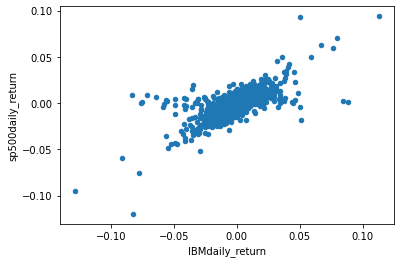

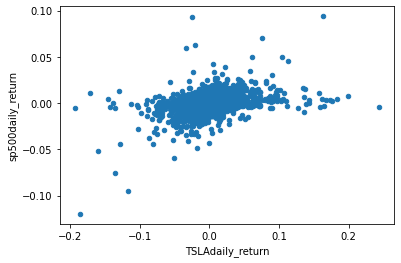

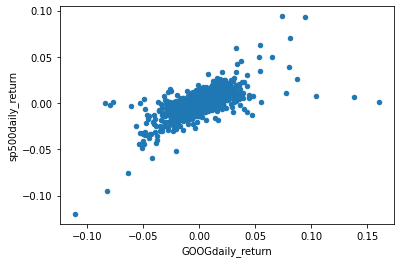

In [52]:
for i in daily.columns[1:9]:
    daily.plot(kind='scatter', x = i , y = 'sp500daily_return')

In [53]:
betatable=pd.DataFrame()
st=[]
b=[]
a=[]
for i in daily.columns[1:9]:
    beta,alpha = np.polyfit(daily['sp500daily_return'],daily[i],1)
    print (f'beta for {i} stocks is {beta} and alpha is {alpha}')
    st.append(i)
    b.append(beta)
    a.append(alpha)

#alpha value shows by how much the portfolio exceeds the benchmark SP500 market rate
# beta = 1 means assets are coorelated to the market pricing
# beta < 1 gives a lesser volatile stock than the market 
# beta > 1 is an aggresive stock that is more volatile than the market like Tech stocks which give high profits in a bullish economy.

beta for AAPLdaily_return stocks is 1.1128924148678099 and alpha is 0.000528120846944028
beta for BAdaily_return stocks is 1.3828672010892784 and alpha is -2.29069832975301e-05
beta for Tdaily_return stocks is 0.7446293454747845 and alpha is -0.0002856343019846153
beta for MGMdaily_return stocks is 1.6535677065180119 and alpha is -0.0001688530552047849
beta for AMZNdaily_return stocks is 0.9917345712576853 and alpha is 0.0010221396417765254
beta for IBMdaily_return stocks is 0.960414914809525 and alpha is -0.000534549415044511
beta for TSLAdaily_return stocks is 1.2686150101095905 and alpha is 0.0017583492165165926
beta for GOOGdaily_return stocks is 1.0348817687428566 and alpha is 0.00033355587214670113


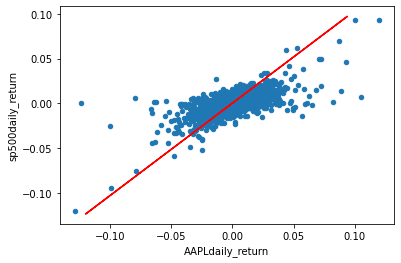

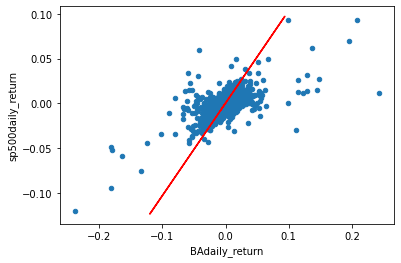

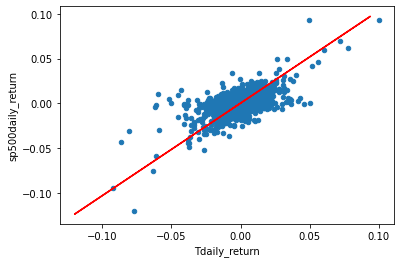

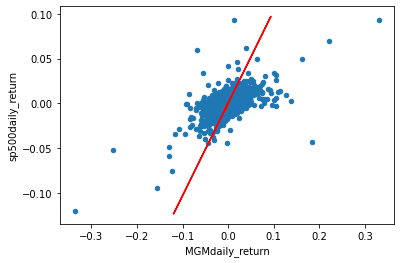

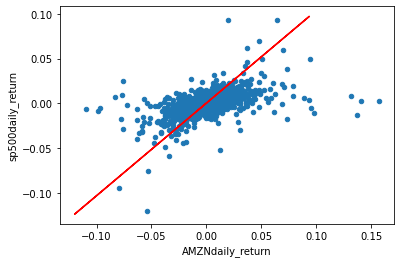

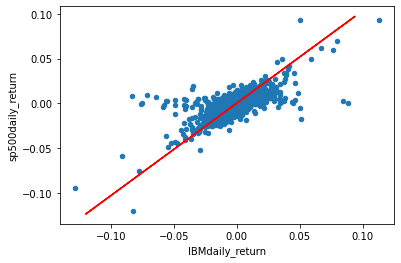

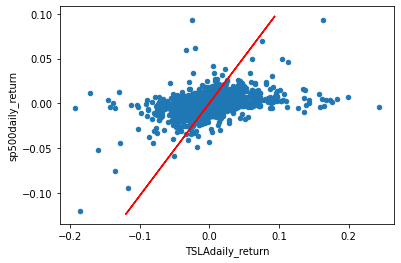

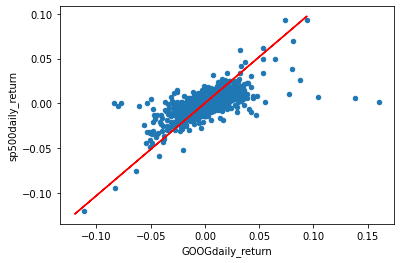

In [54]:
for i in daily.columns[1:9]:
    daily.plot(kind='scatter', x = i , y = 'sp500daily_return')
    plt.plot(daily['sp500daily_return'],beta*daily['sp500daily_return']+alpha, '-', color = 'r')

In [55]:
for i in daily.columns[1:9]:
    fig = px.scatter(daily,x=daily['sp500daily_return'],y = i,title = i)
    beta,alpha = np.polyfit(daily['sp500daily_return'],daily[i],1)
    fig.add_scatter(x=daily['sp500daily_return'],y=beta*daily['sp500daily_return']+alpha)
    fig.show()

In [56]:
betatable['stocks']= st
betatable['beta'] = b
betatable['alpha'] = a
betatable = betatable.sort_values('beta',ascending=False)

In [57]:
avgannual_sp500_dailyreturn = daily['sp500daily_return'].mean()*252
avgannual_sp500_dailyreturn

0.12427633663298061

In [58]:
rf = 0 #risk free rate like govt bonds
betatable['Expected Return'] = rf+(betatable['beta']*(avgannual_sp500_dailyreturn-rf))

In [59]:
betatable

,stocks,beta,alpha,Expected Return
3,MGMdaily_return,1.653568,-0.000169,0.205499
1,BAdaily_return,1.382867,-0.000023,0.171858
6,TSLAdaily_return,1.268615,0.001758,0.157659
0,AAPLdaily_return,1.112892,0.000528,0.138306
7,GOOGdaily_return,1.034882,0.000334,0.128611
4,AMZNdaily_return,0.991735,0.001022,0.123249
5,IBMdaily_return,0.960415,-0.000535,0.119357
2,Tdaily_return,0.744629,-0.000286,0.092540


If an investor takes high risk to invest on highly volatile stocks like MGM, BA, TSLA, AAPL,GOOGL etc the returns are high ranging from 12 to 20 percent.
Investing in non volatile stocks like AT & T, IBM etc you can see lesser interest rates like 9 to 11 percent.

In [60]:
#assume equal weights in portfolio
weight_port = 1/8*np.ones(8)
weight_port

array([0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125, 0.125])

In [61]:
#expected return 
expreturn=sum(betatable['Expected Return'].values*weight_port)*100
print(f'expected return for portfolio is {np.round(expreturn,2)}%')

expected return for portfolio is 14.21%


In [62]:
stock_volume = pd.read_csv(r'stock_volume.csv')

In [63]:
stock_volume

,Date,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
0,2012-01-12,53146800,3934500,26511100,17891100,5385800,6881000,729300,3764400,4019890000
1,2012-01-13,56505400,4641100,22096800,16621800,4753500,5279200,5500400,4631800,3692370000
2,2012-01-17,60724300,3700100,23500200,15480800,5644500,6003400,4651600,3832800,4010490000
3,2012-01-18,69197800,4189500,22015000,18387600,7473500,4600600,1260200,5544000,4096160000
4,2012-01-19,65434600,5397300,25524000,14022900,7096000,8567200,1246300,12657800,4465890000
...,...,...,...,...,...,...,...,...,...,...
2154,2020-08-05,30498000,46551000,22991700,18914200,3930000,3675400,4978000,1979500,4732220000
2155,2020-08-06,50607200,32921600,21908700,35867700,3940600,3417100,5992300,1995400,4267490000
2156,2020-08-07,49453300,19301600,30398500,34530300,3929600,3651000,8883500,1576600,4104860000
2157,2020-08-10,53100900,35857700,35514400,71219700,3167300,3968300,7522300,1289300,4318570000


In [64]:
stock_volume.describe()

,AAPL,BA,T,MGM,AMZN,IBM,TSLA,GOOG,sp500
count,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03,2.159000e+03
mean,5.820332e+07,6.419916e+06,2.832131e+07,9.845582e+06,4.102673e+06,4.453090e+06,7.001302e+06,2.498238e+06,3.680732e+09
std,4.568141e+07,9.711873e+06,1.428911e+07,7.295753e+06,2.290722e+06,2.462811e+06,5.781208e+06,1.928407e+06,8.622717e+08
min,1.136200e+07,7.889000e+05,6.862400e+06,9.507000e+05,8.813000e+05,1.193000e+06,3.649000e+05,7.900000e+03,1.248960e+09
25%,2.769930e+07,3.031850e+06,2.002150e+07,5.796450e+06,2.675700e+06,3.111250e+06,3.433450e+06,1.325400e+06,3.211890e+09
50%,4.209420e+07,3.991000e+06,2.485930e+07,7.899800e+06,3.494800e+06,3.825000e+06,5.581100e+06,1.813900e+06,3.526890e+09
75%,7.182480e+07,5.325900e+06,3.210565e+07,1.104055e+07,4.768150e+06,4.937300e+06,8.619550e+06,3.245350e+06,3.933290e+09
max,3.765300e+08,1.032128e+08,1.950827e+08,9.009820e+07,2.385610e+07,3.049020e+07,6.093880e+07,2.497790e+07,9.044690e+09


In [65]:
stock_volume.isnull().sum()

Date     0
AAPL     0
BA       0
T        0
MGM      0
AMZN     0
IBM      0
TSLA     0
GOOG     0
sp500    0
dtype: int64

In [66]:
stock_volume = stock_volume.sort_values('Date')

In [67]:
interactive_plot(nom(stock_volume),'Normalized')

In [68]:
def ind_stock(price_df,vol_df, name):
    return pd.DataFrame({'Date':price_df['Date'],'Closing price':price_df[name],'Volume':vol_df[name]})

In [69]:
# target price copied as next days price to set ideal targets for prediction
def tradingwindow(data):
    n=1
    data['target'] = data[['Closing price']].shift(-n)
    return data
    

In [70]:
AAPL = ind_stock(stocks,stock_volume,'AAPL')

In [71]:
AAPL = tradingwindow(AAPL)

In [72]:
AAPL

,Date,Closing price,Volume,target
0,2012-01-12,60.198570,53146800,59.972858
1,2012-01-13,59.972858,56505400,60.671429
2,2012-01-17,60.671429,60724300,61.301430
3,2012-01-18,61.301430,69197800,61.107143
4,2012-01-19,61.107143,65434600,60.042858
...,...,...,...,...
2154,2020-08-05,440.250000,30498000,455.609985
2155,2020-08-06,455.609985,50607200,444.450012
2156,2020-08-07,444.450012,49453300,450.910004
2157,2020-08-10,450.910004,53100900,437.500000


In [73]:
AAPL = AAPL[:-1]

In [74]:
AAPL

,Date,Closing price,Volume,target
0,2012-01-12,60.198570,53146800,59.972858
1,2012-01-13,59.972858,56505400,60.671429
2,2012-01-17,60.671429,60724300,61.301430
3,2012-01-18,61.301430,69197800,61.107143
4,2012-01-19,61.107143,65434600,60.042858
...,...,...,...,...
2153,2020-08-04,438.660004,43267900,440.250000
2154,2020-08-05,440.250000,30498000,455.609985
2155,2020-08-06,455.609985,50607200,444.450012
2156,2020-08-07,444.450012,49453300,450.910004


In [75]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range = (0,1))
AAPL_scaled = scaler.fit_transform(AAPL.iloc[:,1:])

In [76]:
X= AAPL_scaled[:,:2]
y = AAPL_scaled[:,-1:]

In [77]:
split = int(0.65*len(X))

In [78]:
X_train = X[:split]
X_test =X[split:]
y_train = y[:split]
y_test = y[split:]

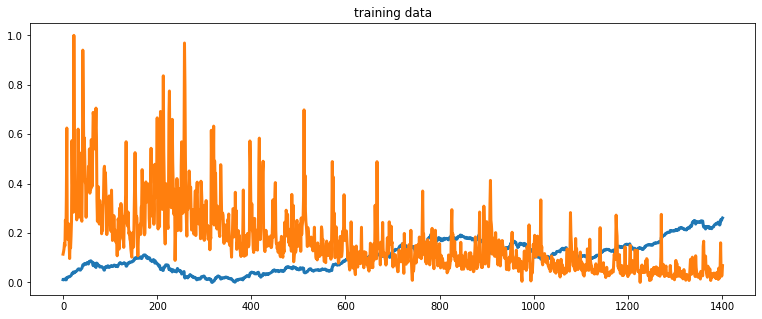

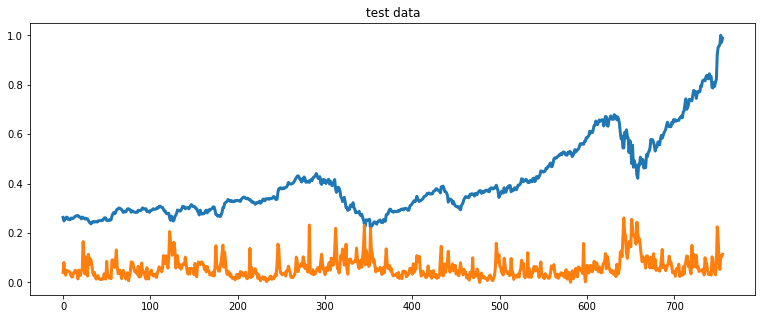

In [79]:
def plott (data,title):
    plt.figure(figsize=(13,5))
    plt.plot(data,linewidth=3)
    plt.title(title)
    plt.show()
plott(X_train,'training data')
plott(X_test,'test data')

In [80]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge

In [81]:
lm=LinearRegression()
rd=Ridge()

In [82]:
X_train.shape

(1402, 2)

In [83]:
y_train.shape

(1402, 1)

In [84]:
X_test.shape

(756, 2)

In [85]:
y_test.shape

(756, 1)

In [86]:
lm.fit(X_train,y_train)
rd.fit(X_train,y_train)
acc1= lm.score(X_test,y_test)
acc2 = rd.score(X_test,y_test)
print(f'Test Accuracy for LM is {acc1} and Ridge is{acc2}')

Test Accuracy for LM is 0.9932260063050166 and Ridge is0.7950028030821767


In [87]:
acc_lm=lm.score(X_train,y_train)
acc_rd = rd.score(X_train,y_train)
print(f'Training Accuracy for LM is {acc_lm} and Ridge is {acc_rd}')

Training Accuracy for LM is 0.9961414596288918 and Ridge is 0.964531696367568


In [88]:
y_predict_lm = lm.predict(X_test)
y_predict_rd = rd.predict(X_test)

In [89]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
mse_lm = mean_squared_error(y_predict_lm,y_test)
mse_rd = mean_squared_error(y_predict_rd,y_test)
print(f'MSE for LM is {mse_lm} and Ridge is{mse_rd}')

MSE for LM is 0.00016248575621436085 and Ridge is0.004917206313269075


In [90]:
predicted_Lm = lm.predict(X)
predicted_Rd=rd.predict(X)
p1=[]
p2=[]
for i in predicted_Lm:
    p1.append(i[0])
for j in predicted_Rd:
    p2.append(j[0])


In [91]:
close=[]
for i in AAPL_scaled:
    close.append(i[0])

In [92]:
AAPL_scaled

array([[0.01102638, 0.11442624, 0.01046185],
       [0.01046185, 0.12362365, 0.01220906],
       [0.01220906, 0.13517696, 0.01378478],
       ...,
       [1.        , 0.10747163, 0.97208751],
       [0.97208751, 0.10431171, 0.98824476],
       [0.98824476, 0.11430054, 0.95470465]])

In [93]:
df_predicted_rd = AAPL[['Date']]
df_predicted_lm = AAPL[['Date']]

In [94]:
df_predicted_rd['Close'] = close
df_predicted_rd['Predictions_Rd'] = p2
df_predicted_lm['Close'] = close
df_predicted_lm['Predictions_Lm'] = p1

In [95]:
interactive_plot(df_predicted_lm,'Original vs Predictions Linear Regression')

In [96]:
interactive_plot(df_predicted_rd,'Original vs Predictions Ridge Regression')

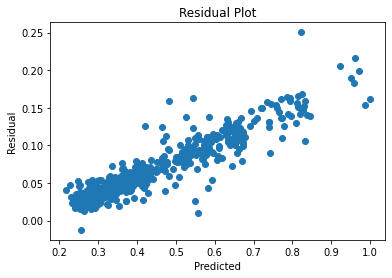

In [97]:
plt.scatter(y_predict_lm, y_test - y_predict_rd)
plt.xlabel("Predicted")
plt.ylabel("Residual")
plt.title("Residual Plot")
plt.show()

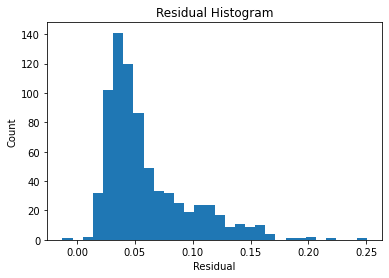

In [98]:
plt.hist(y_test - y_predict_rd,bins = 30)
plt.xlabel("Residual")
plt.ylabel("Count")
plt.title("Residual Histogram")
plt.show()

Too close to a perfect fit with near zero value for mse. Hence regression is not an ideal model.

In [99]:
X1= AAPL_scaled[:,:1]
X1 =  np.asarray(X1)
y =np.asarray(y)
split = int(0.70*len(X))
X_train = X1[:split]
X_test =X1[split:]
y_train = y[:split]
y_test = y[split:]
X_train = np.reshape(X_train, (X_train.shape[0],X_train.shape[1],1))
X_test = np.reshape(X_test, (X_test.shape[0],X_test.shape[1],1))
X_train.shape,X_test.shape

((1510, 1, 1), (648, 1, 1))

In [100]:
from tensorflow import keras

inputs = keras.layers.Input(shape=(X_train.shape[1], X_train.shape[2]))
x = keras.layers.LSTM(150, return_sequences= True)(inputs)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150, return_sequences=True)(x)
x = keras.layers.Dropout(0.3)(x)
x = keras.layers.LSTM(150)(x)
outputs = keras.layers.Dense(1, activation='linear')(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.compile(optimizer='adam', loss="mse")
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 1)]            0         
_________________________________________________________________
lstm (LSTM)                  (None, 1, 150)            91200     
_________________________________________________________________
dropout (Dropout)            (None, 1, 150)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 1, 150)            180600    
_________________________________________________________________
dropout_1 (Dropout)          (None, 1, 150)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 150)               180600    
_________________________________________________________________
dense (Dense)                (None, 1)                 151   

In [101]:
history = model.fit(X_train,y_train,epochs=20,batch_size=32,validation_split=0.2)

Train on 1208 samples, validate on 302 samples
Epoch 1/20
1208/1208 [==============================] - 8s 7ms/sample - loss: 0.0038 - val_loss: 0.0184
Epoch 2/20
1208/1208 [==============================] - 1s 593us/sample - loss: 0.0018 - val_loss: 0.0058
Epoch 3/20
1208/1208 [==============================] - 1s 585us/sample - loss: 1.7970e-04 - val_loss: 1.7227e-05
Epoch 4/20
1208/1208 [==============================] - 1s 542us/sample - loss: 5.4066e-05 - val_loss: 1.7371e-05
Epoch 5/20
1208/1208 [==============================] - 1s 589us/sample - loss: 4.4973e-05 - val_loss: 2.5704e-05
Epoch 6/20
1208/1208 [==============================] - 1s 597us/sample - loss: 4.1171e-05 - val_loss: 1.7975e-05
Epoch 7/20
1208/1208 [==============================] - 1s 637us/sample - loss: 4.2908e-05 - val_loss: 1.6770e-05
Epoch 8/20
1208/1208 [==============================] - 1s 693us/sample - loss: 4.0647e-05 - val_loss: 1.6629e-05
Epoch 9/20
1208/1208 [==============================] - 1s 

In [102]:
X1 = np.reshape(X1, (X1.shape[0],X1.shape[1],1))
predictions_LSTM = model.predict(X1)

In [107]:
y_predict_lstm = model.predict(X_test)
mean_squared_error(y_predict_lstm,y_test)

0.0003961110076750905

In [103]:
test_predicted = []
for i in predictions_LSTM:
  test_predicted.append(i[0])

In [104]:
len(predictions_LSTM)

2158

In [105]:
df_predicted_LSTM = AAPL[['Date']]
close = []
for i in AAPL_scaled:
  close.append(i[0])
df_predicted_LSTM['Close'] = close
df_predicted_LSTM['Predicted'] = test_predicted

In [106]:
interactive_plot(df_predicted_LSTM,'Original vs Predicted')